# The Battle of the Neighborhoods - Istanbul

## Searching for the best neıghborhood to open up a theatre in Istanbul using Data Science

This notebook contains the project called "The Battle of the Neighborhoods - Istanbul". The project is the final assignment of IBM Data Science Professional Certificate Courses (9 of 9).

## Index

### a. Business Understanding

### b. Data Understanding

### c. Target Audience and Expectations

### d. Methodology 

### e. Results & Discussion

### f. Conclusion

### a. Business Understanding

According to Istanbul's Wikipedia page, with a total population of around fifteen million residents, Istanbul is one of the world's largest cities by population, ranking as the world's fifteenth-largest city and the largest city in Europe. Since it is a city which "its' streets are paved with gold", and  prominent in geopolitical and cultural affairs, it is the best city in the country for entrepreneurs to start a business, especially if the business is based on art or cultural products. 

Istanbul is the best city in the country to start a business based on art, hovever, which neighborhood is optimal for a specific venue is a problem remains to be solved. This project aims to solve this problem. We are going to try to find the optimal neighborhood in Istanbul to open a theatre hall, using data science. 

Optimal neighborhood would have a lot of other venues in certain categories, in terms of number and variety, so that people would want to come to the neighborhood frequently. We want to enable them to combine going to a play with other activities, eating outside, going to a pub, meeting friends at a coffee house, etc. On the other hand, it is supposed to have no theatre halls at all or might have a few. This way, competition won't be fierce.

### b. Data Understanding

Based on the business understanding, we are looking at 2 dimensions here, in order to solve the problem at hand: 

- There has to be a lot of other venues in the neighborhood in certain categories, in terms of number and variety.
- Neighborhood is supposed to have no theatre halls at all or might have a few.

Therefore, two sets of analysis will be used together. Both analyses will leverage;

- List of neighborhoods and postal codes from Turkish Postal Service's website: List is maintained in an Excel table on Turkish Postal Service's official website: https://postakodu.ptt.gov.tr/ (Can be downloaded by clicking on "Posta Kodu Özet Tablosu"). This table contains postal codes, city and neighborhood names for entire Turkey. Data regarding Istanbul will be filtered and used.

- Geographical location data of the neighbourhoods from Geocoder package: This data will be used to create maps. (Afternote: Geocoder package didn't produce reliable results. Due to this fact Geopandas package is used)

- Venue data from Foursquare: Venue data is fundamental for this project, it will enable us to find the optimal neighborhood in Istanbul to open a theatre hall,

### c. Target Audience and Expectations

This project is meant to help entrepreneurs to decide which neighborhood is the optimal place to open a theatre hall is Istanbul. Moreover, it is meant to help them to convince potential investors regarding the viability of their future business.

### d. Methodology & Analysis

In this project we are going to try to find neighborhoods of Istanbul that have high restaurant, pub and coffee house variety and density, and have no or few theater halls.

In first step we will collect the required data:

- List of neighborhoods and postal codes (From Turkish Postal Service's official website)
- Geodata for neighborhoods (From Arcgis)
- Geodata for venues (From Foursquare)

After data tidying and combining related data together, we will concentrate on finding optimal neighborhoods with following attributes, in accordance with our shared understanding with stakeholders:

- High density of venues in desired categories (Restaurants, pubs and coffee houses)
- High variety of venues in desired categories (Restaurants, pubs and coffee houses)
- No or few theater hall existence

We will present map of all such locations. Moreover, we will create clusters (using k-means clustering) of those locations in order to identify general zones / neighborhoods which should be a starting point for final exploration and search for optimal venue location that has desired attributes.

### d.1. Gathering & Tidying Data

#### d.1.1. List of neighborhoods and postal codes

List of neighborhoods and postal codes is acquired Turkish Postal Service's official website: https://postakodu.ptt.gov.tr/ (Can be downloaded by clicking on "Posta Kodu Özet Tablosu").

A new database is created and uploaded to Github for the purposes of this project: https://github.com/Omer-Korkmaz/Coursera_Capstone/blob/master/TUR_POSTAL_CODES.csv Headers are translated from Turkish to English and 4th level of detail is eliminated from data (Data included following levels of details. 1st: City, 2nd: Borough, 3rd: Neighborhood, 4th: sub-neighborhood. Postal codes are given based on 3rd level and 4th level is not useful or related with this project).

In [1]:
# Importing necessary libraries
import pandas as pd 
import numpy as np
import requests

In [2]:
# Providing postal code database link
pc_turkey = 'https://raw.githubusercontent.com/Omer-Korkmaz/Coursera_Capstone/master/TUR_POSTAL_CODES.csv'

In [3]:
# Reading postal code database into a pandas dataframe
df_pc = pd.read_csv(pc_turkey, sep=';')

In [4]:
#Checking out the head of dataframe
df_pc.head()

,City,Postcode,Borough,Neighborhood
0,ADANA,1720,ALADAG,ALADAG
1,ADANA,1722,ALADAG,MADENLI
2,ADANA,1922,CEYHAN,BUYUKMANGIT
3,ADANA,1920,CEYHAN,CEYHAN
4,ADANA,1924,CEYHAN,MUSTAFABEYLI


In [5]:
# Checking out the shape
df_pc.shape

(2469, 4)

In [6]:
# Project is about Istanbul. Therefore, forming a new dataframe that only includes data regarding Istanbul.
df_pc_istanbul=df_pc[df_pc['City'].str.contains("ISTANBUL")]

In [7]:
#Checking out the head of new dataframe
df_pc_istanbul.head(20)

,City,Postcode,Borough,Neighborhood
1099,ISTANBUL,34975,ADALAR,BURGAZADA
1100,ISTANBUL,34970,ADALAR,BUYUKADA
1101,ISTANBUL,34973,ADALAR,HEYBELIADA
1102,ISTANBUL,34977,ADALAR,KINALIADA
1103,ISTANBUL,34275,ARNAVUTKOY,ARNAVUTKOY
1104,ISTANBUL,34277,ARNAVUTKOY,BAKLALI
1105,ISTANBUL,34285,ARNAVUTKOY,BOGAZKOY
1106,ISTANBUL,34287,ARNAVUTKOY,BOLLUCA
1107,ISTANBUL,34555,ARNAVUTKOY,HADIMKOY
1108,ISTANBUL,34281,ARNAVUTKOY,HARACCI


In [8]:
# Since it is all about Istanbul, it is better to take columns exluding city column.
df_pc_istanbul2 = df_pc_istanbul[['Postcode','Borough','Neighborhood']]

In [9]:
df_pc_istanbul2.head()

,Postcode,Borough,Neighborhood
1099,34975,ADALAR,BURGAZADA
1100,34970,ADALAR,BUYUKADA
1101,34973,ADALAR,HEYBELIADA
1102,34977,ADALAR,KINALIADA
1103,34275,ARNAVUTKOY,ARNAVUTKOY


#### d.1.2. Geodata for neighborhoods

Installed geopy since env. doesn't include it.

In [10]:
!pip install geopy

     |████████████████████████████████| 112kB 3.3MB/s eta 0:00:01


In [12]:
# Import Nominatim to get geo data of Istanbul
from geopy.geocoders import Nominatim 

In [13]:
# Get geo data of Istanbul
address = 'Istanbul'
geolocator = Nominatim(user_agent="istanbul_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Istanbul are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Istanbul are 41.0096334, 28.9651646.


Geocoder package didn't produce reliable results. Due to this fact Geopandas package will be used.

Installed geopandas since env. doesn't include it.

In [14]:
!pip install geopandas

     |████████████████████████████████| 972kB 7.0MB/s eta 0:00:01
     |████████████████████████████████| 1.0MB 5.2MB/s eta 0:00:01
     |████████████████████████████████| 14.8MB 6.7MB/s eta 0:00:01
     |████████████████████████████████| 6.5MB 7.2MB/s eta 0:00:01
  Using cached https://files.pythonhosted.org/packages/d2/3d/fa76db83bf75c4f8d338c2fd15c8d33fdd7ad23a9b5e57eb6c5de26b430e/click-7.1.2-py2.py3-none-any.whl
  Found existing installation: pyproj 1.9.6
    Uninstalling pyproj-1.9.6:
      Successfully uninstalled pyproj-1.9.6


In [15]:
# Created an "Adress" column to feed to geopandas package. Used zip code and added "Istanbul" to the end, because same zip codes are used in different parts of world.
df_pc_istanbul2['Adress'] = df_pc_istanbul2['Postcode'].astype(str)+', ISTANBUL'

In [16]:
df_pc_istanbul2.head()

,Postcode,Borough,Neighborhood,Adress
1099,34975,ADALAR,BURGAZADA,"34975, ISTANBUL"
1100,34970,ADALAR,BUYUKADA,"34970, ISTANBUL"
1101,34973,ADALAR,HEYBELIADA,"34973, ISTANBUL"
1102,34977,ADALAR,KINALIADA,"34977, ISTANBUL"
1103,34275,ARNAVUTKOY,ARNAVUTKOY,"34275, ISTANBUL"


In [17]:
# Import geopandas
import geopandas

In [18]:
# Created geocode dataframe with geopandas package. Used "Arcgis" as provider, because it doesn't reqire an api key and is produces reliable results.
df_geocode = geopandas.tools.geocode(df_pc_istanbul2.Adress, provider='arcgis')

In [19]:
#Checking out the new dataframe
df_geocode

,geometry,address
1099,POINT (29.06197 40.88023),34975
1100,POINT (29.12311 40.85572),34970
1101,POINT (29.09094 40.87615),34973
1102,POINT (29.04850 40.90841),34977
1103,POINT (28.74328 41.20992),34275
...,...,...
1360,POINT (29.08501 41.04300),34690
1361,POINT (28.89779 40.99265),34025
1362,POINT (28.91192 41.01077),34015
1363,POINT (28.90521 40.99211),34020


In [20]:
# Checking neighborhood df to see if row count mathes
df_pc_istanbul2.shape

(266, 4)

In [21]:
# Writing Latitude and Longitude to seperate variables
df_geocode['Longitude'] = df_geocode['geometry'].x
df_geocode['Latitude'] = df_geocode['geometry'].y

In [22]:
# Creating a "Postcode" variable for merging purposes:
df_geocode['Postcode'] = df_geocode['address'].str[:5]

In [23]:
# Checking out df again
df_geocode

,geometry,address,Longitude,Latitude,Postcode
1099,POINT (29.06197 40.88023),34975,29.061974,40.880225,34975
1100,POINT (29.12311 40.85572),34970,29.123110,40.855719,34970
1101,POINT (29.09094 40.87615),34973,29.090943,40.876150,34973
1102,POINT (29.04850 40.90841),34977,29.048496,40.908410,34977
1103,POINT (28.74328 41.20992),34275,28.743275,41.209924,34275
...,...,...,...,...,...
1360,POINT (29.08501 41.04300),34690,29.085005,41.043003,34690
1361,POINT (28.89779 40.99265),34025,28.897785,40.992650,34025
1362,POINT (28.91192 41.01077),34015,28.911920,41.010765,34015
1363,POINT (28.90521 40.99211),34020,28.905205,40.992106,34020


In [24]:
# Checking common variable in neighborhood df to see dtype
df_pc_istanbul2.Postcode

1099    34975
1100    34970
1101    34973
1102    34977
1103    34275
        ...  
1360    34690
1361    34025
1362    34015
1363    34020
1364    34010
Name: Postcode, Length: 266, dtype: int64

In [25]:
# Checking common variable in geocode df to see dtype
df_geocode.Postcode

1099    34975
1100    34970
1101    34973
1102    34977
1103    34275
        ...  
1360    34690
1361    34025
1362    34015
1363    34020
1364    34010
Name: Postcode, Length: 266, dtype: object

In [26]:
# Changing neighborhood df's Postcode dtype to str
df_pc_istanbul2.Postcode = df_pc_istanbul2.Postcode.astype('str')

In [27]:
# Checking again to confirm dtypes matches
df_pc_istanbul2.Postcode

1099    34975
1100    34970
1101    34973
1102    34977
1103    34275
        ...  
1360    34690
1361    34025
1362    34015
1363    34020
1364    34010
Name: Postcode, Length: 266, dtype: object

In [28]:
# Merging 2 dataframes
df_ist_geo = pd.merge(df_pc_istanbul2, df_geocode, on='Postcode', how='left')

In [29]:
# Checking out the new dataframe
df_ist_geo

,Postcode,Borough,Neighborhood,Adress,geometry,address,Longitude,Latitude
0,34975,ADALAR,BURGAZADA,"34975, ISTANBUL",POINT (29.06197 40.88023),34975,29.061974,40.880225
1,34970,ADALAR,BUYUKADA,"34970, ISTANBUL",POINT (29.12311 40.85572),34970,29.123110,40.855719
2,34973,ADALAR,HEYBELIADA,"34973, ISTANBUL",POINT (29.09094 40.87615),34973,29.090943,40.876150
3,34977,ADALAR,KINALIADA,"34977, ISTANBUL",POINT (29.04850 40.90841),34977,29.048496,40.908410
4,34275,ARNAVUTKOY,ARNAVUTKOY,"34275, ISTANBUL",POINT (28.74328 41.20992),34275,28.743275,41.209924
...,...,...,...,...,...,...,...,...
261,34690,USKUDAR,YAVUZTURK,"34690, ISTANBUL",POINT (29.08501 41.04300),34690,29.085005,41.043003
262,34025,ZEYTINBURNU,CIRPICI,"34025, ISTANBUL",POINT (28.89779 40.99265),34025,28.897785,40.992650
263,34015,ZEYTINBURNU,SEYITNIZAM,"34015, ISTANBUL",POINT (28.91192 41.01077),34015,28.911920,41.010765
264,34020,ZEYTINBURNU,TELSIZ,"34020, ISTANBUL",POINT (28.90521 40.99211),34020,28.905205,40.992106


In [30]:
# Creating a new df with necessary variables only
df_ist_geo2 = df_ist_geo[['Postcode', 'Borough', 'Neighborhood', 'Latitude', 'Longitude']]

In [31]:
# Checking new df
df_ist_geo2

,Postcode,Borough,Neighborhood,Latitude,Longitude
0,34975,ADALAR,BURGAZADA,40.880225,29.061974
1,34970,ADALAR,BUYUKADA,40.855719,29.123110
2,34973,ADALAR,HEYBELIADA,40.876150,29.090943
3,34977,ADALAR,KINALIADA,40.908410,29.048496
4,34275,ARNAVUTKOY,ARNAVUTKOY,41.209924,28.743275
...,...,...,...,...,...
261,34690,USKUDAR,YAVUZTURK,41.043003,29.085005
262,34025,ZEYTINBURNU,CIRPICI,40.992650,28.897785
263,34015,ZEYTINBURNU,SEYITNIZAM,41.010765,28.911920
264,34020,ZEYTINBURNU,TELSIZ,40.992106,28.905205


#### d.1.3. Geodata for venues

In [40]:
# Loaded other needed packages for rest of the assigment
import os
from sklearn.cluster import KMeans
import folium 
import matplotlib.cm as cm
import matplotlib.colors as colors
import matplotlib.pyplot as plt

In [44]:
# Setting up auth. info for Foursquare
CLIENT_ID = 'EORFEJPAFM441ACUU35DWEJ2YCF2GC2LEHNNLE0TUHUY3KL0'
CLIENT_SECRET = '3MD11DEVC0WNSN1NHNSILUPLUWOL1AMI3FVO3RAA43IUFQZ1' 
VERSION = '20201214'

In [45]:
# Define function to get venue data
def getNearbyVenues(names, latitudes, longitudes):
    radius=500
    LIMIT=100
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
            
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

In [46]:
# Create venues of Istanbul df
venues_of_istanbul = getNearbyVenues(names=df_ist_geo2['Neighborhood'],
                                   latitudes=df_ist_geo2['Latitude'],
                                   longitudes=df_ist_geo2['Longitude']
                                  )

BURGAZADA                     
BUYUKADA                      
HEYBELIADA                    
KINALIADA                     
ARNAVUTKOY                    
BAKLALI                       
BOGAZKOY                      
BOLLUCA                       
HADIMKOY                      
HARACCI                       
TASOLUK                       
ATATURK                       
FERHATPASA                    
ICERENKOY                     
KAYISDAGI                     
KUCUKBAKKALKOY                
MUSTAFAKEMAL                  
ORNEK                         
YENICAMLICA                   
YENISAHRA                     
AMBARLI                       
AVCILAR                       
FIRUZKOY                      
GUMUSPALA                     
BAGCILAR                      
GUNESLI                       
MAHMUTBEY                     
BAHCELIEVLER                  
SIRINEVLER                    
YENIBOSNA                     
ATAKOY                        
CEVIZLIK                      
FLORYA  

In [47]:
# Check out venues data
venues_of_istanbul.head()

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,BURGAZADA,40.880225,29.061974,Burgazada Kalpazan Kayalarì,40.880424,29.065728,Campground
1,BURGAZADA,40.880225,29.061974,Sait Faik Abasıyanık Müzesi,40.881015,29.067458,History Museum
2,BURGAZADA,40.880225,29.061974,Peyote Cennet Bahçesi,40.884498,29.063283,Beer Garden
3,BURGAZADA,40.880225,29.061974,Cennet Bahçesi/ Burgaz Ada,40.884500,29.063331,Garden
4,BURGAZADA,40.880225,29.061974,Bayraktepe,40.877576,29.063138,Scenic Lookout


### d.2. Exploratory Data Analysis

#### d.2.1. General Analysis

In [48]:
# Creating a grouped count to see density of venues in each neighborhood
venues_of_istanbul.groupby('Neighborhood').count()

,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
Neighborhood,,,,,,
ABBASAGA,100,100,100,100,100,100
ACIBADEM,39,39,39,39,39,39
AKATLAR,57,57,57,57,57,57
AKINCILAR,83,83,83,83,83,83
AKSARAY,40,40,40,40,40,40
...,...,...,...,...,...,...
ZEYREK,59,59,59,59,59,59
ZEYTINLIK,100,100,100,100,100,100
ZUBEYDEHANIM,18,18,18,18,18,18


In [49]:
# Checking out how many venues are there in each neighborhood
neighborhood_summary = venues_of_istanbul.groupby('Neighborhood').count().reset_index()
neighborhood_summary['Count'] = neighborhood_summary['Venue']
neighborhood_summary = neighborhood_summary.drop(['Neighborhood Latitude', 'Neighborhood Longitude', 'Venue', 'Venue Latitude', 'Venue Longitude','Venue Category'], axis=1)
neighborhood_summary = neighborhood_summary.sort_values(by='Count', ascending=False).reset_index(drop=True)

In [50]:
neighborhood_summary.head(30)

,Neighborhood,Count
0,MIMARSINAN,157
1,BAHCELIEVLER,157
2,CUMHURIYET,132
3,TOPKAPI,115
4,ISTIKLAL,100
5,TESVIKIYE,100
6,BAYAZIT,100
7,OSMANAGA,100
8,EMINONU,100
9,TURKALI,100


In [51]:
# create map of Istanbul using latitude and longitude values
map_istanbul = folium.Map(location=[latitude, longitude], zoom_start=10)
map_istanbul

# add markers to map
for lat, lng, Neighborhood in zip(venues_of_istanbul['Venue Latitude'], venues_of_istanbul['Venue Longitude'], venues_of_istanbul['Neighborhood']):
    label = '{}'.format(Neighborhood)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_istanbul)  
    
map_istanbul

**Neighborhood Summary table and the concentration on the map above provides us with neighborhoods that have highest number of venues. At this point, it is important to remember the problem to solve. Even though neighborhoods that have highest number of venues provides an idea regarding popular neighborhoods, according to business understanding, it is assumed that only cafes, restaurants, bars and pubs are important for analysis.**

In [52]:
# According to assumption stated above, creating a new df with venues that have following words in venue category variable: Café|Restaurant|Pub|Bar|Coffee
venues_of_istanbul2=venues_of_istanbul[venues_of_istanbul['Venue Category'].str.contains("Café|Restaurant|Pub|Bar|Coffee")]

In [53]:
# Checking out how many venues are there in each neighborhood with new venue df
neighborhood_summary2 = venues_of_istanbul2.groupby('Neighborhood').count().reset_index()
neighborhood_summary2['Count'] = neighborhood_summary2['Venue']
neighborhood_summary2 = neighborhood_summary2.drop(['Neighborhood Latitude', 'Neighborhood Longitude', 'Venue', 'Venue Latitude', 'Venue Longitude','Venue Category'], axis=1)
neighborhood_summary2 = neighborhood_summary2.sort_values(by='Count', ascending=False).reset_index(drop=True)

In [54]:
neighborhood_summary2.head(30)

,Neighborhood,Count
0,ABBASAGA,62
1,CAFERAGA,59
2,TOPKAPI,58
3,MIMARSINAN,58
4,OSMANAGA,56
5,YALI,54
6,ARAPCAMI,54
7,KEMANKES,53
8,CUMHURIYET,51
9,ISTIKLAL,50


In [55]:
# create map of Istanbul 2 using latitude and longitude values
map_istanbul2 = folium.Map(location=[latitude, longitude], zoom_start=10)
map_istanbul2

# add markers to map
for lat, lng, Neighborhood in zip(venues_of_istanbul2['Venue Latitude'], venues_of_istanbul2['Venue Longitude'], venues_of_istanbul2['Neighborhood']):
    label = '{}'.format(Neighborhood)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(map_istanbul2)  
    
map_istanbul2

#### d.2.2. Analysis of Each Neighborhood
Use one hot encoding
<br> Add neighborhood column back to dataframe
<br> Move neighborhood column to the first order
<br> Check out the new dataframe

In [56]:
oh_istanbul = pd.get_dummies(venues_of_istanbul2[['Venue Category']], prefix="", prefix_sep="")
oh_istanbul['Neighborhood'] = venues_of_istanbul2['Neighborhood'] 
oh_istanbul.drop(['Neighborhood'],axis=1,inplace=True) 
oh_istanbul.insert(loc=0, column='Neighborhood', value=venues_of_istanbul2['Neighborhood'] )
oh_istanbul.shape

(3891, 81)

In [57]:
#Group  by neighborhood and by taking the mean of the frequency of occurrence of each category
gby_istanbul = oh_istanbul.groupby('Neighborhood').mean().reset_index()
gby_istanbul

,Neighborhood,Afghan Restaurant,African Restaurant,American Restaurant,Arepa Restaurant,Argentinian Restaurant,Asian Restaurant,Austrian Restaurant,Bar,Beach Bar,...,Tantuni Restaurant,Thai Restaurant,Theme Restaurant,Tiki Bar,Turkish Coffeehouse,Turkish Home Cooking Restaurant,Turkish Restaurant,Vegetarian / Vegan Restaurant,Whisky Bar,Wine Bar
0,ABBASAGA,0.0,0.0,0.00000,0.0,0.000000,0.000000,0.0,0.048387,0.0,...,0.0,0.0,0.0,0.0,0.0,0.016129,0.064516,0.0,0.0,0.0
1,ACIBADEM,0.0,0.0,0.00000,0.0,0.000000,0.000000,0.0,0.000000,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.125000,0.0,0.0,0.0
2,AKATLAR,0.0,0.0,0.00000,0.0,0.000000,0.000000,0.0,0.000000,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.047619,0.0,0.0,0.0
3,AKINCILAR,0.0,0.0,0.03125,0.0,0.000000,0.000000,0.0,0.000000,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.250000,0.0,0.0,0.0
4,AKSARAY,0.0,0.0,0.00000,0.0,0.071429,0.071429,0.0,0.071429,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.214286,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
212,ZEYREK,0.0,0.0,0.00000,0.0,0.000000,0.000000,0.0,0.000000,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.227273,0.0,0.0,0.0
213,ZEYTINLIK,0.0,0.0,0.00000,0.0,0.000000,0.000000,0.0,0.042553,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.106383,0.0,0.0,0.0
214,ZUBEYDEHANIM,0.0,0.0,0.00000,0.0,0.000000,0.000000,0.0,0.000000,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.500000,0.0,0.0,0.0
215,ZUHURATBABA,0.0,0.0,0.00000,0.0,0.000000,0.000000,0.0,0.000000,0.0,...,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.0


#### d.2.3. See top 10 venues in each neigborhood

In [58]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

In [59]:
num_top_venues = 10

indicators = ['st', 'nd', 'rd']

columns = ['Neighborhood']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

sorted_nv = pd.DataFrame(columns=columns)
sorted_nv['Neighborhood'] = gby_istanbul['Neighborhood']

for ind in np.arange(gby_istanbul.shape[0]):
    sorted_nv.iloc[ind, 1:] = return_most_common_venues(gby_istanbul.iloc[ind, :], num_top_venues)

sorted_nv

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,ABBASAGA,Coffee Shop,Café,Pub,Turkish Restaurant,Bar,Hookah Bar,Restaurant,Falafel Restaurant,Fondue Restaurant,Seafood Restaurant
1,ACIBADEM,Café,Coffee Shop,Restaurant,Italian Restaurant,Turkish Restaurant,Kebab Restaurant,Eastern European Restaurant,Ethiopian Restaurant,Falafel Restaurant,Fast Food Restaurant
2,AKATLAR,Café,Coffee Shop,Italian Restaurant,Kebab Restaurant,Modern European Restaurant,Sushi Restaurant,Turkish Restaurant,Hookah Bar,Filipino Restaurant,Eastern European Restaurant
3,AKINCILAR,Café,Turkish Restaurant,Hookah Bar,Restaurant,Comfort Food Restaurant,American Restaurant,Coffee Shop,Middle Eastern Restaurant,Doner Restaurant,Fast Food Restaurant
4,AKSARAY,Café,Turkish Restaurant,Restaurant,Doner Restaurant,Argentinian Restaurant,Asian Restaurant,Bar,French Restaurant,Eastern European Restaurant,Ethiopian Restaurant
...,...,...,...,...,...,...,...,...,...,...,...
212,ZEYREK,Café,Turkish Restaurant,Coffee Shop,Restaurant,Fast Food Restaurant,Wine Bar,Fondue Restaurant,Eastern European Restaurant,Ethiopian Restaurant,Falafel Restaurant
213,ZEYTINLIK,Café,Coffee Shop,Restaurant,Turkish Restaurant,Seafood Restaurant,Fast Food Restaurant,Bar,Salon / Barbershop,Kebab Restaurant,Sushi Restaurant
214,ZUBEYDEHANIM,Turkish Restaurant,Restaurant,Kebab Restaurant,Wine Bar,Fondue Restaurant,Dumpling Restaurant,Eastern European Restaurant,Ethiopian Restaurant,Falafel Restaurant,Fast Food Restaurant
215,ZUHURATBABA,Cocktail Bar,Café,Wine Bar,French Restaurant,Eastern European Restaurant,Ethiopian Restaurant,Falafel Restaurant,Fast Food Restaurant,Filipino Restaurant,Fondue Restaurant


### d.3. Clustering

#### d.3.1. Clustering Neighborhoods by:
Set K (First, I randomly choose K as 5 and then check if it is the optimal K using elbow method)
<br> Run k-means clustering
<br> Check out cluster labels
<br> Add labels
<br> Merge dataframes to add geo info to each neighborhood
<br> Check out the data

In [60]:
k = 5
istanbul_clustering = gby_istanbul.drop('Neighborhood', 1)
kmeans = KMeans(n_clusters=k, random_state=0).fit(istanbul_clustering)
kmeans.labels_[0:10] 

array([0, 0, 3, 2, 2, 0, 2, 3, 3, 2], dtype=int32)

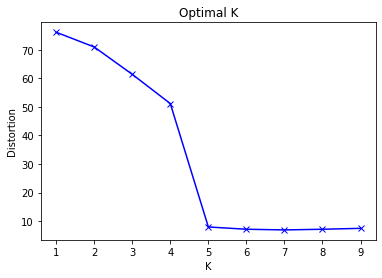

In [61]:
from scipy.spatial.distance import cdist

distortions = []
K = range(1,10)
for k in K:
    kmeanModel = KMeans(n_clusters=k, random_state=0).fit(istanbul_clustering)
    kmeanModel.fit(istanbul_clustering)
    distortions.append(sum(np.min(cdist(istanbul_clustering, kmeanModel.cluster_centers_, 'canberra'), axis=1)) / istanbul_clustering.shape[0])

plt.plot(K, distortions, 'bx-')
plt.xlabel('K')
plt.ylabel('Distortion')
plt.title('Optimal K')
plt.show()

Above figure shows that optimal K is 5. 

In [62]:
sorted_nv.insert(0, 'Clusters', kmeans.labels_)
merged_istanbul = df_ist_geo2
merged_istanbul = merged_istanbul.join(sorted_nv.set_index('Neighborhood'), on='Neighborhood')

In [63]:
merged_istanbul

,Postcode,Borough,Neighborhood,Latitude,Longitude,Clusters,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,34975,ADALAR,BURGAZADA,40.880225,29.061974,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,34970,ADALAR,BUYUKADA,40.855719,29.123110,3.0,Café,Restaurant,Wine Bar,Fondue Restaurant,Dumpling Restaurant,Eastern European Restaurant,Ethiopian Restaurant,Falafel Restaurant,Fast Food Restaurant,Filipino Restaurant
2,34973,ADALAR,HEYBELIADA,40.876150,29.090943,1.0,Café,Wine Bar,Doner Restaurant,Eastern European Restaurant,Ethiopian Restaurant,Falafel Restaurant,Fast Food Restaurant,Filipino Restaurant,Fondue Restaurant,French Restaurant
3,34977,ADALAR,KINALIADA,40.908410,29.048496,0.0,Beach Bar,Café,Kebab Restaurant,Seafood Restaurant,Wine Bar,Eastern European Restaurant,Ethiopian Restaurant,Falafel Restaurant,Fast Food Restaurant,Filipino Restaurant
4,34275,ARNAVUTKOY,ARNAVUTKOY,41.209924,28.743275,0.0,Seafood Restaurant,Restaurant,Café,Coffee Shop,Cocktail Bar,Turkish Restaurant,Hookah Bar,Bar,Eastern European Restaurant,Ethiopian Restaurant
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
261,34690,USKUDAR,YAVUZTURK,41.043003,29.085005,2.0,Turkish Restaurant,Coffee Shop,Wine Bar,French Restaurant,Dumpling Restaurant,Eastern European Restaurant,Ethiopian Restaurant,Falafel Restaurant,Fast Food Restaurant,Filipino Restaurant
262,34025,ZEYTINBURNU,CIRPICI,40.992650,28.897785,3.0,Café,Restaurant,Turkish Restaurant,Dumpling Restaurant,Coffee Shop,Fast Food Restaurant,Fondue Restaurant,Eastern European Restaurant,Ethiopian Restaurant,Falafel Restaurant
263,34015,ZEYTINBURNU,SEYITNIZAM,41.010765,28.911920,3.0,Café,Restaurant,Turkish Restaurant,Kebab Restaurant,Indonesian Restaurant,Turkish Home Cooking Restaurant,Eastern European Restaurant,Fast Food Restaurant,Fondue Restaurant,Dumpling Restaurant
264,34020,ZEYTINBURNU,TELSIZ,40.992106,28.905205,0.0,Turkish Restaurant,Restaurant,Coffee Shop,Fast Food Restaurant,Dumpling Restaurant,Hotel Bar,Hookah Bar,Doner Restaurant,Mediterranean Restaurant,Café


In [64]:
#We made an assumption and included certain venue categories in our analysis. Consequently, some neighborhoods did not fall under any cluster. Since we do not have any interest over these neighborhoods, we can drop them.
merged_istanbul2 = merged_istanbul[merged_istanbul['Clusters'].notna()]

In [65]:
merged_istanbul2

,Postcode,Borough,Neighborhood,Latitude,Longitude,Clusters,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
1,34970,ADALAR,BUYUKADA,40.855719,29.123110,3.0,Café,Restaurant,Wine Bar,Fondue Restaurant,Dumpling Restaurant,Eastern European Restaurant,Ethiopian Restaurant,Falafel Restaurant,Fast Food Restaurant,Filipino Restaurant
2,34973,ADALAR,HEYBELIADA,40.876150,29.090943,1.0,Café,Wine Bar,Doner Restaurant,Eastern European Restaurant,Ethiopian Restaurant,Falafel Restaurant,Fast Food Restaurant,Filipino Restaurant,Fondue Restaurant,French Restaurant
3,34977,ADALAR,KINALIADA,40.908410,29.048496,0.0,Beach Bar,Café,Kebab Restaurant,Seafood Restaurant,Wine Bar,Eastern European Restaurant,Ethiopian Restaurant,Falafel Restaurant,Fast Food Restaurant,Filipino Restaurant
4,34275,ARNAVUTKOY,ARNAVUTKOY,41.209924,28.743275,0.0,Seafood Restaurant,Restaurant,Café,Coffee Shop,Cocktail Bar,Turkish Restaurant,Hookah Bar,Bar,Eastern European Restaurant,Ethiopian Restaurant
9,34281,ARNAVUTKOY,HARACCI,41.184955,28.707398,1.0,Café,Wine Bar,Doner Restaurant,Eastern European Restaurant,Ethiopian Restaurant,Falafel Restaurant,Fast Food Restaurant,Filipino Restaurant,Fondue Restaurant,French Restaurant
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
261,34690,USKUDAR,YAVUZTURK,41.043003,29.085005,2.0,Turkish Restaurant,Coffee Shop,Wine Bar,French Restaurant,Dumpling Restaurant,Eastern European Restaurant,Ethiopian Restaurant,Falafel Restaurant,Fast Food Restaurant,Filipino Restaurant
262,34025,ZEYTINBURNU,CIRPICI,40.992650,28.897785,3.0,Café,Restaurant,Turkish Restaurant,Dumpling Restaurant,Coffee Shop,Fast Food Restaurant,Fondue Restaurant,Eastern European Restaurant,Ethiopian Restaurant,Falafel Restaurant
263,34015,ZEYTINBURNU,SEYITNIZAM,41.010765,28.911920,3.0,Café,Restaurant,Turkish Restaurant,Kebab Restaurant,Indonesian Restaurant,Turkish Home Cooking Restaurant,Eastern European Restaurant,Fast Food Restaurant,Fondue Restaurant,Dumpling Restaurant
264,34020,ZEYTINBURNU,TELSIZ,40.992106,28.905205,0.0,Turkish Restaurant,Restaurant,Coffee Shop,Fast Food Restaurant,Dumpling Restaurant,Hotel Bar,Hookah Bar,Doner Restaurant,Mediterranean Restaurant,Café


#### d.3.2. Show Clustering on the Map by:

Use geopy to get the latitude and longitude values of Istanbul
<br>Then use it and previously gathered data to create the map
<br> Set color scheme
<br> Add markers

In [66]:
address = 'Istanbul'
geolocator = Nominatim(user_agent="istanbul_explorer")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of Istanbul are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of Istanbul are 41.0096334, 28.9651646.


In [67]:
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=11)

x = np.arange(k)
ys = [i + x + (i*x)**2 for i in range(k)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

markers_colors = []
for lat, lon, poi, cluster in zip(merged_istanbul2['Latitude'], merged_istanbul2['Longitude'], merged_istanbul2['Neighborhood'], merged_istanbul2['Clusters']):
    label = folium.Popup(str(poi) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[int(cluster)-1],
        fill=True,
        fill_color=rainbow[int(cluster)-1],
        fill_opacity=0.7).add_to(map_clusters)
       
map_clusters

#### d.3.3. Analysis of Clusters by Venue Categories

In [68]:
# It is possible to see top venue occurrence in each cluster
istanbul_count_top = merged_istanbul2
istanbul_count_top = istanbul_count_top.drop(['Postcode', 'Borough','Neighborhood', 'Latitude', 'Longitude'], axis=1)
istanbul_count_top = istanbul_count_top.groupby(['Clusters','1st Most Common Venue']).size().reset_index(name='Counts')

count_top_cluster = istanbul_count_top.pivot(index='Clusters', columns='1st Most Common Venue', values='Counts')
count_top_cluster = count_top_cluster.fillna(0).astype(int).reset_index(drop=True)
count_top_cluster

1st Most Common Venue,Afghan Restaurant,Bar,Beach Bar,Café,Cocktail Bar,Coffee Shop,Comfort Food Restaurant,Doner Restaurant,Fast Food Restaurant,Hotel Bar,Italian Restaurant,Kebab Restaurant,Pub,Public Art,Restaurant,Seafood Restaurant,Sports Bar,Turkish Coffeehouse,Turkish Home Cooking Restaurant,Turkish Restaurant
0,0,1,1,33,0,11,1,1,2,1,1,2,0,1,14,3,1,1,1,4
1,0,0,0,14,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,24,0,0,0,0,3,0,0,3,1,0,0,0,0,0,0,27
3,0,0,0,74,1,0,1,0,0,0,0,0,0,0,3,0,0,0,0,0
4,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


Text(0, 0.5, 'Clusters')

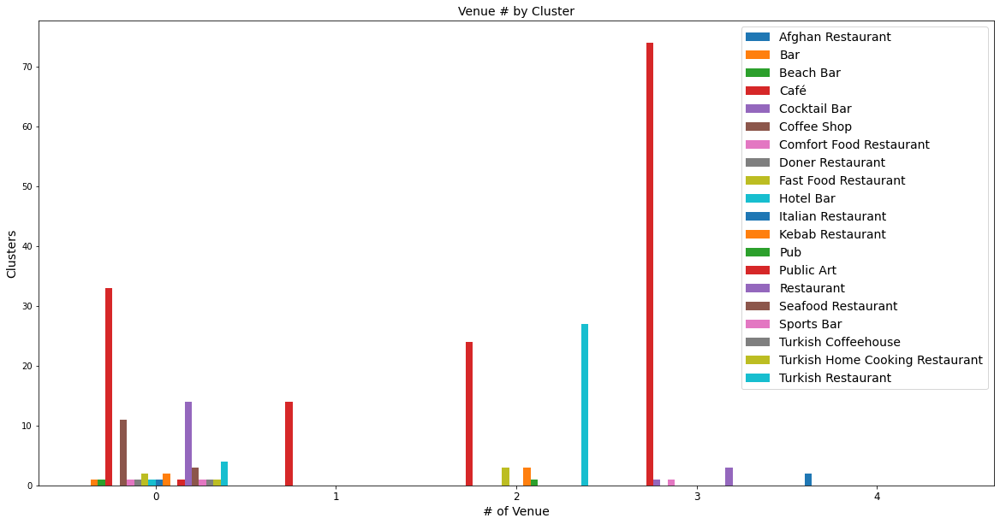

In [69]:
# Now we can see distribution of venues in clusters so that we can make a decision regarding which cluster fits our purpose best.

bar_count_top_cluster=count_top_cluster.plot(kind='bar',figsize=(20,10),width = 0.8)

plt.legend(labels=count_top_cluster.columns,fontsize= 14)
plt.title("Venue # by Cluster",fontsize= 14)
plt.xticks(fontsize=12)
plt.xticks(rotation=0)
plt.xlabel('# of Venue', fontsize=14)
plt.ylabel('Clusters', fontsize=14)

**Above figure shows us that, in terms of variety of venue categories, cluster 0 has optimal neighborhoods.**

### d.4. Neigborhoods and Theatere Hall Analysis

Until this point, we established neighborhoods in cluster 0 are most diverse in terms of venue category. Moreover, we listed neighborhoods with highest number of venues. Neigborhoods in the intersection set of these two valuable deductions will have our eyes on them. Then we can see which ones have the least number of theatre halls and this will be our final product.

Assumption: Top 20 neighborhoods in terms of venue count in cluster 0 will be researched for least number of theatre halls.

In [70]:
# Let's take the neighborhoods with number of venues and merge it with cluster info df
target_neighborhoods = pd.merge(neighborhood_summary2, merged_istanbul2, on='Neighborhood', how='left')

In [71]:
# Let's see new df
target_neighborhoods

,Neighborhood,Count,Postcode,Borough,Latitude,Longitude,Clusters,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue,8th Most Common Venue,9th Most Common Venue,10th Most Common Venue
0,ABBASAGA,62,34022,BESIKTAS,41.046519,29.006215,0.0,Coffee Shop,Café,Pub,Turkish Restaurant,Bar,Hookah Bar,Restaurant,Falafel Restaurant,Fondue Restaurant,Seafood Restaurant
1,CAFERAGA,59,34710,KADIKOY,40.986025,29.025368,3.0,Café,Coffee Shop,Bar,Restaurant,Pub,Fast Food Restaurant,Italian Restaurant,Cocktail Bar,Seafood Restaurant,Sushi Restaurant
2,TOPKAPI,58,34093,FATIH,41.017185,28.934966,0.0,Café,Comfort Food Restaurant,Coffee Shop,Turkish Restaurant,Restaurant,Pub,Fast Food Restaurant,Middle Eastern Restaurant,Seafood Restaurant,Doner Restaurant
3,TOPKAPI,58,34010,ZEYTINBURNU,41.019560,28.911448,0.0,Café,Comfort Food Restaurant,Coffee Shop,Turkish Restaurant,Restaurant,Pub,Fast Food Restaurant,Middle Eastern Restaurant,Seafood Restaurant,Doner Restaurant
4,MIMARSINAN,58,34535,BUYUKCEKMECE,41.009701,28.546122,3.0,Café,Coffee Shop,Turkish Restaurant,Turkish Home Cooking Restaurant,Kebab Restaurant,Kokoreç Restaurant,Restaurant,Seafood Restaurant,Fast Food Restaurant,Middle Eastern Restaurant
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
227,BUYUKCEKMECE,1,34500,BUYUKCEKMECE,41.068306,28.595050,0.0,Turkish Home Cooking Restaurant,Wine Bar,French Restaurant,Dumpling Restaurant,Eastern European Restaurant,Ethiopian Restaurant,Falafel Restaurant,Fast Food Restaurant,Filipino Restaurant,Fondue Restaurant
228,BAHCESEHIR,1,34488,BASAKSEHIR,41.090743,28.678305,0.0,Restaurant,Wine Bar,Dive Bar,Dumpling Restaurant,Eastern European Restaurant,Ethiopian Restaurant,Falafel Restaurant,Fast Food Restaurant,Filipino Restaurant,Fondue Restaurant
229,TASOLUK,1,34283,ARNAVUTKOY,41.201743,28.717750,1.0,Café,Wine Bar,Doner Restaurant,Eastern European Restaurant,Ethiopian Restaurant,Falafel Restaurant,Fast Food Restaurant,Filipino Restaurant,Fondue Restaurant,French Restaurant
230,TOKATKOY,1,34825,BEYKOZ,41.154780,29.128093,0.0,Hotel Bar,Wine Bar,French Restaurant,Dumpling Restaurant,Eastern European Restaurant,Ethiopian Restaurant,Falafel Restaurant,Fast Food Restaurant,Filipino Restaurant,Fondue Restaurant


In [72]:
# Creating a new df with necessary colums only
target_neighborhoods2 = target_neighborhoods[['Neighborhood', 'Count', 'Clusters']]

In [73]:
# And according to our analysis so far, creating a new df with neighborhoods in cluster 0 and sorting them based on venue count. We will remove duplicates based on Neighborhoods since they have same data. And filter out top 20 based on our assumption.
target_neighborhoods3 = target_neighborhoods2[(target_neighborhoods2.Clusters == 0.0)]
target_neighborhoods4 = target_neighborhoods3.sort_values(by='Count', ascending=False).reset_index(drop=True)
target_neighborhoods5 = target_neighborhoods4.drop_duplicates(subset=['Neighborhood']).reset_index(drop=True)
target_neighborhoods6 = target_neighborhoods5[0:20]

In [74]:
# Checking out new df
target_neighborhoods6

,Neighborhood,Count,Clusters
0,ABBASAGA,62,0.0
1,TOPKAPI,58,0.0
2,ARAPCAMI,54,0.0
3,CUMHURIYET,51,0.0
4,ISTIKLAL,50,0.0
5,TESVIKIYE,48,0.0
6,ZEYTINLIK,47,0.0
7,CADDEBOSTAN,46,0.0
8,TURKALI,44,0.0
9,TAKSIM,44,0.0


In [75]:
# According to assumption stated above, creating a new df with venues that are located on top 20 neighborhoods in terms of venue count and are in neighborhoods in cluster 0 
venues_of_istanbul3=venues_of_istanbul[venues_of_istanbul['Neighborhood'].str.contains("|".join(target_neighborhoods6['Neighborhood']))]

In [76]:
venues_of_istanbul3

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
1300,ZEYTINLIK,40.979117,28.871853,Paşabahçe Mağazaları,40.977734,28.870596,Arts & Crafts Store
1301,ZEYTINLIK,40.979117,28.871853,Mert Güler Yoga ve Farkındalık,40.978058,28.870276,Yoga Studio
1302,ZEYTINLIK,40.979117,28.871853,Saç Kaynak Atölyesi,40.978159,28.871919,Salon / Barbershop
1303,ZEYTINLIK,40.979117,28.871853,Kitapçılar Köprüsü,40.979981,28.870722,Bookstore
1304,ZEYTINLIK,40.979117,28.871853,UP! watch,40.979458,28.873132,Watch Shop
...,...,...,...,...,...,...,...
10521,TOPKAPI,41.019560,28.911448,Oba Restorant&sultan Cafe,41.022782,28.915126,Comfort Food Restaurant
10522,TOPKAPI,41.019560,28.911448,Ülker,41.022719,28.915456,Dessert Shop
10523,TOPKAPI,41.019560,28.911448,Tim 2,41.022192,28.914722,Electronics Store
10524,TOPKAPI,41.019560,28.911448,Marmaris Büfe Topkapı,41.022018,28.916139,Fast Food Restaurant


In [77]:
# Let's find theater halls that are in these neighborhoods
venues_of_istanbul4 = venues_of_istanbul3[venues_of_istanbul3['Venue Category'].str.contains("Theater")]

In [78]:
venues_of_istanbul4

,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
1685,ABBASAGA,41.046519,29.006215,BKM Ata Demirer Gazinosu,41.043437,29.006058,Theater
2517,ARAPCAMI,41.025625,28.971709,ikincikat- karaköy,41.025116,28.970269,Theater
2587,ARAPCAMI,41.025625,28.971709,Asmalı Sahne,41.029315,28.973412,Theater
2601,CIHANGIR,41.033477,28.981690,Hayalhane (Mahşer-i Cümbüş HayalHane Tiyatrosu),41.034146,28.981003,Theater
2650,CIHANGIR,41.033477,28.981690,Grand Pera Emek Sahnesi,41.034917,28.979234,Movie Theater
2742,ISTIKLAL,41.031080,28.972903,Asmalı Sahne,41.029315,28.973412,Theater
3106,TAKSIM,41.037300,28.988279,Kafika - Kaçırdığınız Filmler Kahvesi,41.033525,28.987919,Movie Theater
3140,TARLABASI,41.038790,28.977890,Yota Doğaçlama,41.035804,28.980138,Theater
3167,TARLABASI,41.038790,28.977890,Ses - 1885 Ortaoyuncular Tiyatrosu,41.034616,28.978592,Theater
3177,TARLABASI,41.038790,28.977890,Grand Pera Emek Sahnesi,41.034917,28.979234,Movie Theater


In [79]:
# Let's count and sort
target_neighborhoods_7 = venues_of_istanbul4.groupby('Neighborhood').count().reset_index()
target_neighborhoods_7['Count'] = target_neighborhoods_7['Venue']
target_neighborhoods_7 = target_neighborhoods_7.drop(['Neighborhood Latitude', 'Neighborhood Longitude', 'Venue', 'Venue Latitude', 'Venue Longitude','Venue Category'], axis=1)
target_neighborhoods_7 = target_neighborhoods_7.sort_values(by='Count', ascending=False).reset_index(drop=True)

In [80]:
target_neighborhoods_7

,Neighborhood,Count
0,TARLABASI,3
1,ARAPCAMI,2
2,CIHANGIR,2
3,ABBASAGA,1
4,BOZKURT,1
5,ESENTEPE,1
6,HALASKARGAZI,1
7,HARBIYE,1
8,ISTIKLAL,1
9,SUADIYE,1


As we can see, there were 20 neighborhoods and only 10 contains a theatre hall in them. Now, we can merge top 20 neighborhoods table with this one and be done with it :)

In [81]:
# Merging 2 dfs
target_neighborhoods8 = pd.merge(target_neighborhoods6, target_neighborhoods_7, on='Neighborhood', how='left')

# Replacing NaNs with 0s for sorting purposes
target_neighborhoods8['Count_y'] = target_neighborhoods8['Count_y'].fillna(0)

# Eliminating unnecessary Cluster column
target_neighborhoods9 = target_neighborhoods8[['Neighborhood', 'Count_x', 'Count_y']]

# Renaming columns
target_neighborhoods10 = target_neighborhoods9.rename(columns={'Count_x':'No. of Related Venues'})
target_neighborhoods11 = target_neighborhoods10.rename(columns={'Count_y':'No. of Theatre Halls'})
target_neighborhoods_final = target_neighborhoods11.sort_values(by=['No. of Related Venues', 'No. of Theatre Halls'], ascending=[False, True])
target_neighborhoods_final

,Neighborhood,No. of Related Venues,No. of Theatre Halls
0,ABBASAGA,62,1.0
1,TOPKAPI,58,0.0
2,ARAPCAMI,54,2.0
3,CUMHURIYET,51,0.0
4,ISTIKLAL,50,1.0
5,TESVIKIYE,48,0.0
6,ZEYTINLIK,47,0.0
7,CADDEBOSTAN,46,0.0
8,TURKALI,44,0.0
10,FENERBAHCE,44,0.0


**This is the final table. We can present this table along with other other alaysis to target audience.**

### e. Results & Discussion

Our analysis revealed that, even though there are great number of venues in Istanbul, there are certain clusters of neighborhoods that stands out, in terms of variety of venues and among them, there are certain neighborhoods that stands out in terms of number of venues.

We focused on venues in certain categories, restaurants, pubs and coffee houses. Based on these venues, we created clusters of neighborhoods and saw that, there are differences between zones, in terms of venue variety. After this point, in accordance with our shared business understanding with stakeholders, we concentrated on cluster 0 which has highest variety of venues in our desired venue categories. Thereafter, we took 20 most dense neighborhoods in terms of venue number in cluster 0 and looked for theater halls.

Result of all this is a table with 20 neighborhoods, that have:

- High density of venues in desired categories (Restaurants, pubs and coffee houses)
- High variety of venues in desired categories (Restaurants, pubs and coffee houses)
- No or few theater hall existence

### f. Conclusion

This project is aimed at finding an optimal neighborhood in Istanbul to open a theater hall.

As a result of our analyses, we identified 20 neighborhoods, that have high density of venues in desired categories, high variety of venues in desired categoriesand no or few theater hall existence in them. This information shed a light on one aspect of a complicated problem.

Final decision regarding optimal neighborhood must be based on several more analyses alongside this one, i.e. on rent levels, levels of income, education levels and other demographical aspects of neighborhoods.  Then stakeholders can make an informed decision.